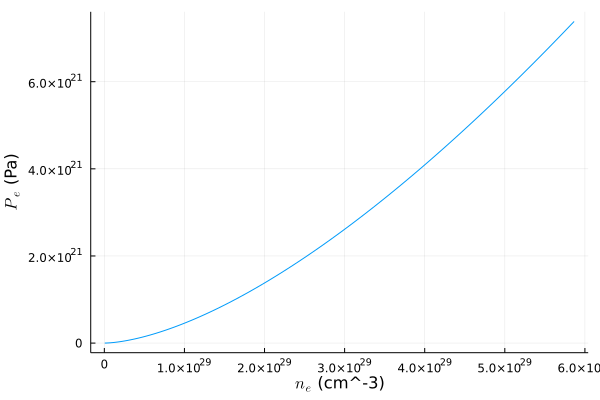

In [135]:
# Import various packages
using Unitful
using Unitful.DefaultSymbols # Dimensions 𝐋,𝐌,𝐓,𝐈,𝚯,𝐉,𝐍 for length, mass, time, current, temperature, luminosity, and amount
using PhysicalConstants.CODATA2018: m_e, c_0, h, G, m_u
using Plots
using UnitfulRecipes # add unit support to plots
using LaTeXStrings
using UnitfulLatexify
using Interpolations
using UnitfulAstro

# Define custom dimensions for use as a type
# We could use 𝐍 to specify amount as an dimension but then it expects units for
# it and I don't see a need to introduce moles here.
@derived_dimension NumberDensity 𝐋^(-3)

# Mean weight per electron
# The 2 is based on value from https://www.physics.unlv.edu/~jeffery/astro/star/white_dwarf/white_dwarf_mass_radius_relation.html
# However 1.5 seems to give 'better' results - at least a max mass closer to expectations.
# Really the molecular mass per electron, μ_e, is 2 but we want it in mass units so we'll bring in m_u here
μe = 2 * m_u

# Define our functions 
# I spent a very long time trying to fix a problem traced back to 
# accidentally multiplying instead of adding in here. Ugh.
f(x::Real)::Real = x * (2 * x^2 - 3) * sqrt(x^2 + 1) + 3 * log(x + sqrt(1 + x^2)) # Eq 15.14
ne(x::Real)::NumberDensity = x^3 * 8 * π * m_e^3 * c_0^3 / (3 * h^3) # Eq. 15.15
Pe(x::Real)::Unitful.Pressure = f(x) * π * m_e^4 * c_0^5 / (3 * h^3) # Eq 15.13

# We'll add a couple of functions extrapolated from the rest
x(n_e::NumberDensity)::Real = n_e^(1 / 3) * (1 / (8 * π * m_e^3 * c_0^3 / (3 * h^3)))^(1 / 3)
Pe(n_e::NumberDensity)::Unitful.Pressure = Pe(x(n_e)) # Using Julia's multiple dispatch to select Pe function based on parameter type
Pe(ρ::Unitful.Density)::Unitful.Pressure = Pe(x(ρ / μe))

# Now we can do some plotting
x1 = 0.1:0.01:1
n_e = uconvert.(u"cm^-3", ne.(x1))
P_e = uconvert.(u"Pa", Pe.(x1))
p1 = plot(n_e, P_e, xlabel=L"n_e", ylabel=L"P_e", legend=false)
display(p1)

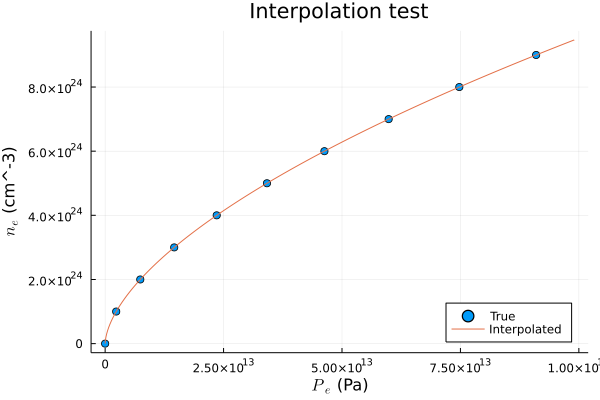

In [136]:
# Lets do some interpolation testing
n_e = (1:1e10:1e12) * 1e13u"cm^-3"
P_e = uconvert.(u"Pa", Pe.(n_e))
inter_ne = linear_interpolation(P_e, n_e, extrapolation_bc=Line())
ine(x) = inter_ne(x)

# Plot it so we can see if it is resolving ok
# For some reason this plot displays with a gap on my desktop but not on my laptop
p3 = scatter(P_e[1:10:end], n_e[1:10:end], label="True", xlabel=L"P_e", ylabel=L"n_e")
P_e4 = (0:1e8:9.9e13) * 1u"Pa"
plot!(P_e4, ine, title="Interpolation test", label="Interpolated", legend=:bottomright)
display(p3)

# Free up some memory next time gc runs, probably unnecessary 
n_e = nothing
P_e = nothing
inter_ne = nothing

In [137]:
solar_mass = 1u"Msun"
radius = 1u"Rearth"

mean_density = solar_mass * 3 / (4 * π * radius^3)

0.238732414637843 M⊙ R⊕^-3

In [138]:
# Now to setup our actual interpolation
# We'll leave our the extrapolation option this time, so it'll throw an error if we exceed the range
# Why do it so late? So we know the core density.

ne_max = upreferred(2 * mean_density / μe) # arbitary max, trying to leave ourselves a buffer
ne_range = (0:0.001:1) * ne_max
inter_ne = linear_interpolation(Pe.(ne_range), ne_range, extrapolation_bc=Line())
inter_ρ(P) = inter_ne(P) * μe;

The first equation of stellar structure (mass conservation) is
$$\frac{dm}{dr} = 4\pi r^2 \rho$$
hence
$$\frac{dr}{dm} = \frac{1}{4\pi r^2 \rho}$$

The second equation of stellar structure (hydrostatic equilibrium) is
$$\frac{dP}{dr} = -\frac{Gm\rho}{r^2}$$
Combining this with our other derivative gives
$$\frac{dP}{dm} = \frac{dP}{dr}\frac{dr}{dm} = -\frac{Gm\rho}{r^2} \frac{1}{4\pi r^2 \rho}$$
and thus
$$\frac{dP}{dm} = -\frac{Gm}{4 \pi r^4}

In [139]:
struct Star
    """Structure of a star. Vectors are aligned such that pressure[1] = pressure at radius[1] and so forth."""
    radius::Vector{Unitful.Length}
    pressure::Vector{Unitful.Pressure}
    mass::Vector{Unitful.Mass}
    density::Vector{Unitful.Density}
end

function print_star(s::Star)
    """Display properties of star with basic formatting."""
    m = uconvert.(u"Msun", s.mass)
    r = uconvert.(u"Rearth", s.radius)
    P = uconvert.(u"Pa", s.pressure)
    ρ = uconvert.(u"kg/m^3", s.density)
    display([m r P ρ])
end

function model_star(core_density::Unitful.Density, dm::Unitful.Mass=1e-4u"Msun"; silent::Bool=false)::Star
    """Model white dwarf using Shooting method given core density and mass step size (optional)."""

    # We'll store results in arrays
    # Preallocated for efficiency.
    n_shells = Int(ceil(5u"Msun" / dm)) # Set a sensible maximum by capping mass
    r = Vector{Unitful.Length}(undef, n_shells)
    P = Vector{Unitful.Pressure}(undef, n_shells)
    m = Vector{Unitful.Mass}(undef, n_shells)
    ρ = Vector{Unitful.Density}(undef, n_shells)

    # Core
    # Mass is zero at centre
    # Assuming just hydrogen

    # Test runs showed that results are sensitive to this.
    # Larger m[1] tended to lower max mass and allowed us to approach the 1.44Msun theoretical max
    # However, this caused the pressure plots near the end to diverge in ways that made me think the
    # star unstable.
    m[1] = dm
    

    ρ[1] = core_density
    r[1] = (3 * m[1] / (4π * ρ[1]))^(1 / 3) # inverting m = (4/3)πρr^3
    P[1] = Pe(ρ[1])

    # Then iterate over shells
    for i in 2:n_shells
        # Since we're using Unitful and specifiying types for the result vectors 
        # we'll get a type error if the results come out in the wrong units
        # This gives us a handy check on the validity of our equations

        m[i] = m[i-1] + dm

        d_P = dm * G * m[i-1] / (4π * r[i-1]^4)
        P[i] = P[i-1] - d_P

        ρ[i] = inter_ρ(P[i])

        d_r = dm / (4π * r[i-1]^2 * ρ[i-1])
        r[i] = r[i-1] + d_r

        #Check if pressure and/or density are nonphysical
        # Can't compare across units so we'll strip them
        # Alternatively we could compare with 0u"Pa" etc but that adds overhead
        if ustrip(P[i]) < 0 || ustrip(ρ[i]) < 0
            if !silent
                println("Non-physical value reached after $i shells. Halting.")
            end
            return Star(r[1:i-1], P[1:i-1], m[1:i-1], ρ[1:i-1])
        elseif i == n_shells
            # If we hit this something is probably wrong.
            throw("Error: Reached maximum number of runs ($n_shells) without going non-physical.")
        end
    end
end

s1 = model_star(mean_density)
print_star(s1)

5017×4 Matrix{Quantity{Float64}}:
 0.0001 M⊙  0.0464159 R⊕  6.70539e21 Pa  1.82955e9 kg m^-3
 0.0002 M⊙  0.0618879 R⊕  6.67805e21 Pa  1.82469e9 kg m^-3
 0.0003 M⊙   0.070614 R⊕  6.66075e21 Pa  1.82161e9 kg m^-3
 0.0004 M⊙  0.0773281 R⊕  6.64544e21 Pa  1.81888e9 kg m^-3
 0.0005 M⊙  0.0829352 R⊕  6.63125e21 Pa  1.81635e9 kg m^-3
 0.0006 M⊙  0.0878166 R⊕  6.61784e21 Pa  1.81396e9 kg m^-3
 0.0007 M⊙  0.0921762 R⊕  6.60503e21 Pa  1.81168e9 kg m^-3
 0.0008 M⊙  0.0961381 R⊕  6.59273e21 Pa  1.80948e9 kg m^-3
 0.0009 M⊙  0.0997846 R⊕  6.58085e21 Pa  1.80736e9 kg m^-3
  0.001 M⊙   0.103173 R⊕  6.56933e21 Pa   1.8053e9 kg m^-3
         ⋮                               
 0.5009 M⊙    1.46449 R⊕   1.0886e18 Pa  8.30539e6 kg m^-3
  0.501 M⊙    1.46791 R⊕  9.50417e17 Pa  7.69647e6 kg m^-3
 0.5011 M⊙    1.47159 R⊕  8.13493e17 Pa  7.00213e6 kg m^-3
 0.5012 M⊙    1.47561 R⊕  6.77906e17 Pa  6.16322e6 kg m^-3
 0.5013 M⊙    1.48016 R⊕  5.43764e17 Pa  5.33326e6 kg m^-3
 0.5014 M⊙    1.48538 R⊕  4.11236e17 Pa

Non-physical value reached after 5018 shells. Halting.


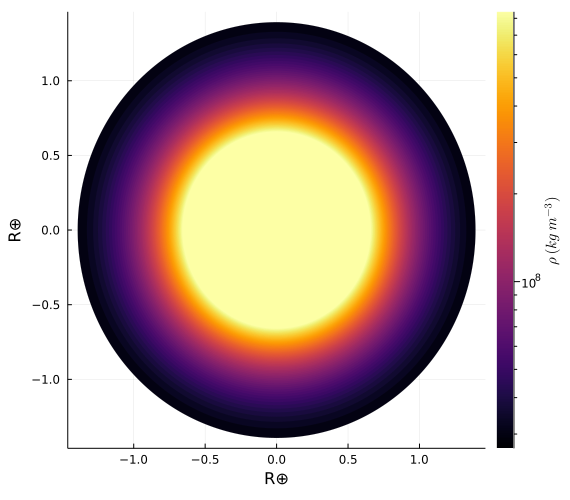

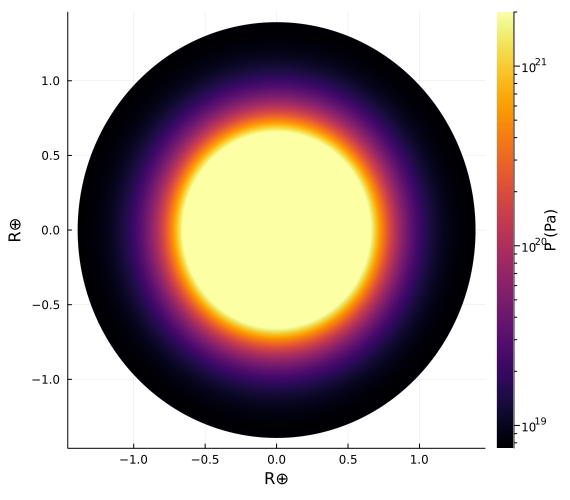

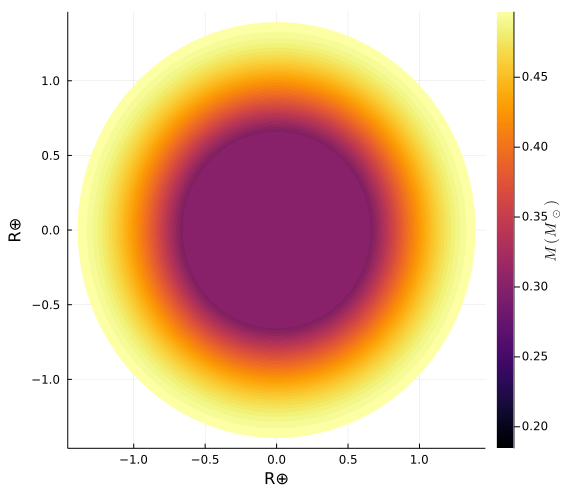

In [140]:
import ColorSchemes.inferno

function plot_star(s::Star)
    x(r, t) = r * cos(t)
    y(r, t) = r * sin(t)


    t = 0:0.01:2π
    rings = reverse(Int.(ceil.(exp.(0:0.015:1) * length(s.radius) / exp(1))))
    #rings = reverse(1:50:length(s.radius))
    radius = uconvert.(u"Rearth", s.radius[rings])
    rmax = 1.05 * ustrip(radius[1])
    density = uconvert.(u"kg/m^3", s.density[rings])
    scaled_density = density / maximum(density)
    colours = get(inferno, scaled_density)
    p = plot(legend=false, colorbar=true, colorbar_title=L"\rho \ (kg\ m^{-3})", colorbar_scale=:log10, lims=(-rmax, rmax), size=(570, 500))
    for (r, ρ, c) in zip(radius, density, colours)
        plot!(x.(r, t), y.(r, t), line_z=ρ, linecolor=:inferno, fillcolor=c, fillrange=0, linewidth=0)
    end
    display(p)

    pressure = uconvert.(u"Pa", s.pressure[rings])
    scaled_pressure = pressure / maximum(pressure)
    colours = get(inferno, scaled_pressure)
    p2 = plot(legend=false, colorbar=true, colorbar_title="P (Pa)", colorbar_scale=:log10, lims=(-rmax, rmax), size=(570, 500))
    for (r, P, c) in zip(radius, pressure, colours)
        plot!(x.(r, t), y.(r, t), line_z=P, linecolor=:inferno, fillcolor=c, fillrange=0, linewidth=0)
    end
    display(p2)

    mass = uconvert.(u"Msun", s.mass[rings])
    scaled_mass = mass / maximum(mass)
    colours = get(inferno, scaled_mass)
    p3 = plot(legend=false, colorbar=true, colorbar_title=L"M\ (M_\odot)", lims=(-rmax, rmax), size=(570, 500))
    for (r, m, c) in zip(radius, mass, colours)
        plot!(x.(r, t), y.(r, t), line_z=m, linecolor=:inferno, fillcolor=c, fillrange=0, linewidth=0)
    end
    display(p3)
end

plot_star(s1)

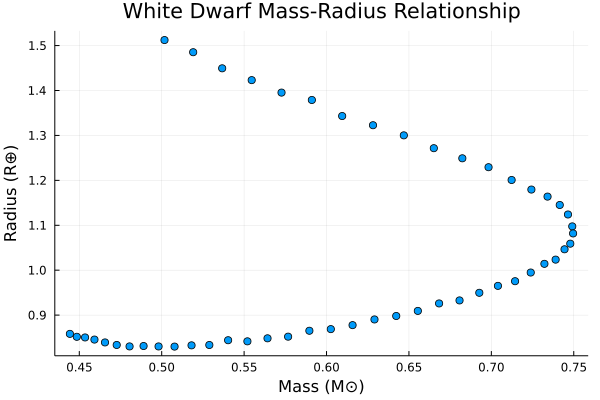

Maximum mass: 0.7495999999999338 M⊙


In [141]:
"""Using multiple plots for clarity in various ranges"""

density = exp.(0:0.1:5)*mean_density
stars = Vector{Star}()
radii = Vector{Unitful.Length}()
masses = Vector{Unitful.Mass}()

for d in density
    s = model_star(d, silent=true)
    push!(stars, s)
    push!(radii, s.radius[end])
    push!(masses, s.mass[end])
end

display(scatter(uconvert.(u"Msun", masses), uconvert.(u"Rearth", radii), xlabel="Mass", ylabel="Radius", legend=false, title="White Dwarf Mass-Radius Relationship"))
println("Maximum mass: $(maximum(masses))")

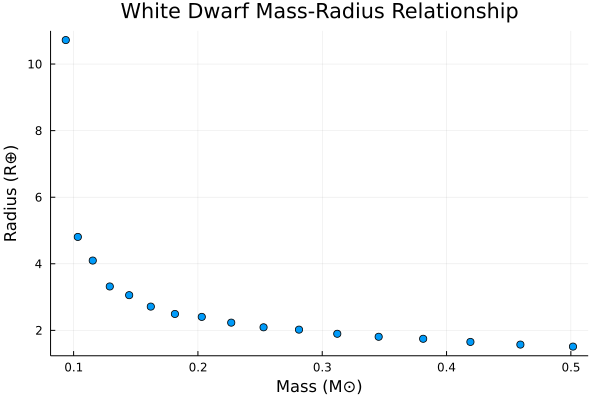

Minimum mass: 0.09370000000000166 M⊙


In [142]:
if μe == 1.5m_u
    # Using the other density range causes star modelling to fail by reaching shell max while P and ρ are still physical
    density = (0.02185:0.001:0.05)*mean_density
else
    density = exp.(-4:0.25:0)*mean_density
end

stars = Vector{Star}()
radii = Vector{Unitful.Length}()
masses = Vector{Unitful.Mass}()

for d in density
    s = model_star(d, silent=true)
    push!(stars, s)
    push!(radii, s.radius[end])
    push!(masses, s.mass[end])
end

display(scatter(uconvert.(u"Msun", masses), uconvert.(u"Rearth", radii), xlabel="Mass", ylabel="Radius", legend=false, title="White Dwarf Mass-Radius Relationship"))
println("Minimum mass: $(minimum(masses))")

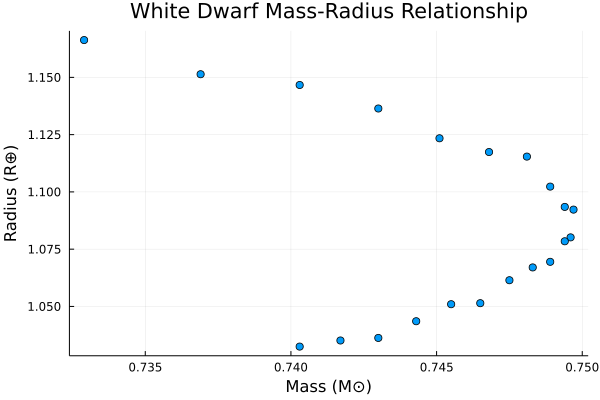

In [143]:
"""I find it odd that I can't reach the 1.4 Msun theoretical max. In fact my max is ~1/2 that. Coincidence?
I don't think so but if there is a problem I can't trace it.

Futher experimentation found that lowering m[1] helped, but made the later pressure plots turn odd."""

density = (4:0.2:8)*mean_density
stars = Vector{Star}()
radii = Vector{Unitful.Length}()
masses = Vector{Unitful.Mass}()

for d in density
    s = model_star(d, silent=true)
    push!(stars, s)
    push!(radii, s.radius[end])
    push!(masses, s.mass[end])
end

scatter(uconvert.(u"Msun", masses), uconvert.(u"Rearth", radii), xlabel="Mass", ylabel="Radius", legend=false, title="White Dwarf Mass-Radius Relationship")

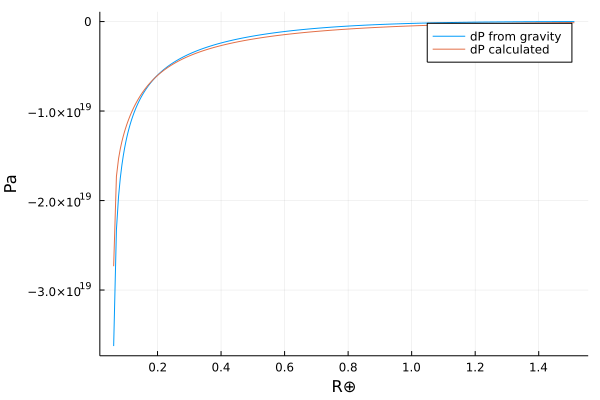

In [144]:
"""If you google white dwarf mass-radius plots you don't observe the same loopback I have here.
That make me skeptical about my own results so I figured I'd see if the gravity and the electron pressure balanced out.
This plot show reasonable agreement on the later values but a dramatic discrepency at the beginning
(the first value has been excluded because the difference was so great the rest of the plot was unreadable)."""

d_R = s1.radius - [s1.radius[1]*0; s1.radius[1:end-1]]
d_P = s1.pressure - [s1.pressure[1]*0; s1.pressure[1:end-1]]

plot(uconvert.(u"Rearth", s1.radius)[2:end], uconvert.(u"Pa", - (4π*G/3) .* s1.density.^2 .* s1.radius .* d_R)[2:end], label="dP from gravity")
plot!(uconvert.(u"Rearth", s1.radius)[2:end], uconvert.(u"Pa", d_P)[2:end], label="dP calculated")

Our results don't show the expected maximum and minimum for mass with the given configuration. However, changing $\mu_e$ from 2 to 1.5 does. As this conflicts with my source for $\mu_e$ I have stuck with my initial configuration. To see the other simply change the definition of $\mu e$, found early in the first cell and then run all cells. You will see that the maximum mass is now ~1.4 Msun and the minimum 0.2 Msun, which is closer to our expect 0.1-1.4 Msun range.

We'll end by comparing with some actual stars. Data obtained from https://www.montrealwhitedwarfdatabase.org with the following filters
![searchfilters](dbfilters.png)

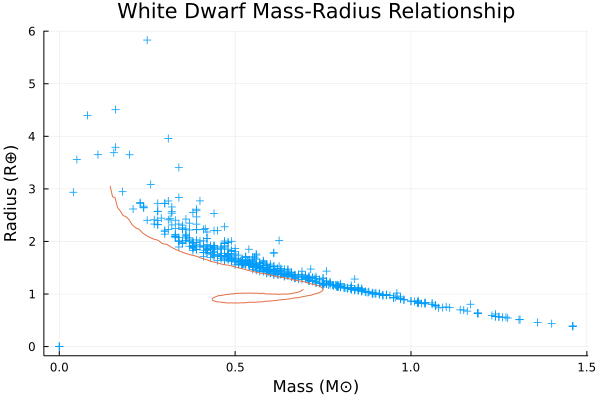

In [152]:
using CSV

fi = CSV.File("MWDD-export.csv")
mass = fi[:mass] * 1u"Msun"
g = 10 .^ fi[:logg] * 1u"cm/s^2"
radius = uconvert.(u"Rearth", sqrt.(G * mass ./ g))
scatter(mass, radius, markershape=:auto)


density = exp.(-3:0.1:10)*mean_density
stars = Vector{Star}()
radii = Vector{Unitful.Length}()
masses = Vector{Unitful.Mass}()

for d in density
    s = model_star(d, silent=true)
    push!(stars, s)
    push!(radii, s.radius[end])
    push!(masses, s.mass[end])
end

plot!(uconvert.(u"Msun", masses), uconvert.(u"Rearth", radii), xlabel="Mass", ylabel="Radius", legend=false, title="White Dwarf Mass-Radius Relationship")


This provides a good fit, until we get to our maximum modelled mass. After that the equations seem to break down. This is perhaps because we're assuming a fully degenerate gas when in truth it should only be partially degenerate? $\mu_e$=1.5 presents a similar curve, but shifted up so that it presents a much poorer match.